In [1]:
import os 
from sklearn import tree
import graphviz
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn import metrics
from sklearn.model_selection import cross_val_predict
from sklearn import preprocessing
import jenkspy
from sklearn.metrics import PrecisionRecallDisplay
import osmnx as ox
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

In [2]:
folder_path = "./Datasets/input_data_for_train/"

In [3]:
pickle_files = [f for f in os.listdir(folder_path) if f.startswith('input_data_') and f.endswith('.pickle')]

In [4]:
len(pickle_files)

19

In [5]:
gdfs = []
for file in pickle_files:
    file_path = os.path.join(folder_path, file)
    gdf = pd.read_pickle(file_path)
    gdf.to_crs(4326, inplace=True) 
    gdfs.append(gdf)
    print(f"Loaded {file} with {len(gdf)} rows")

Loaded input_data_Красногвардейский.pickle with 6343 rows
Loaded input_data_Приморский.pickle with 10490 rows
Loaded input_data_Калининский.pickle with 5610 rows
Loaded input_data_Невский.pickle with 8092 rows
Loaded input_data_Тара.pickle with 8340 rows
Loaded input_data_Мегион.pickle with 4645 rows
Loaded input_data_Курортный.pickle with 13738 rows
Loaded input_data_Фрунзенский.pickle with 6552 rows
Loaded input_data_Петроградский.pickle with 3488 rows
Loaded input_data_Колпинский.pickle with 7307 rows
Loaded input_data_Василеостровский.pickle with 3784 rows
Loaded input_data_Красносельский.pickle with 14877 rows
Loaded input_data_Выборгский.pickle with 13350 rows
Loaded input_data_Адмиралтейский.pickle with 4434 rows
Loaded input_data_Петродворцовый.pickle with 11120 rows
Loaded input_data_Центральный.pickle with 5481 rows
Loaded input_data_Кронштадтский.pickle with 1430 rows
Loaded input_data_Кировский.pickle with 5935 rows
Loaded input_data_Московский.pickle with 7354 rows


In [6]:
combined_gdf = pd.concat(gdfs, ignore_index=True)

print(f"\nTotal rows in combined GeoDataFrame: {len(combined_gdf)}")
print(f"CRS of combined GeoDataFrame: {combined_gdf.crs}")



Total rows in combined GeoDataFrame: 142370
CRS of combined GeoDataFrame: EPSG:4326


In [7]:
def nominal_transform(input_data, value_tags):
    ohe = preprocessing.OneHotEncoder(sparse_output = False)
    for tag in value_tags:
        ohe_results = ohe.fit_transform(input_data[[tag]])
        input_data.reset_index(inplace=True, drop=True)
        input_data = pd.concat([input_data, \
            pd.DataFrame(ohe_results, columns=ohe.categories_[0].tolist())], axis=1)
        input_data.drop(columns=[tag], inplace=True)
        
    return input_data

In [8]:
value_tags = ['building','landuse']
nominal_data = combined_gdf.copy()

nominal_data = nominal_transform(nominal_data, value_tags)
nominal_features = list(nominal_data.columns[2:])
nominal_features

['buffer_cat1_30',
 'buffer_cat1_60',
 'buffer_cat1_90',
 'buffer_cat2_30',
 'buffer_cat2_60',
 'buffer_cat2_90',
 'buffer_cat3_30',
 'buffer_cat3_60',
 'buffer_cat3_90',
 'buffer_cat4_30',
 'buffer_cat4_60',
 'buffer_cat4_90',
 'shop',
 'website',
 'brand',
 'amenity',
 'building:levels',
 'name',
 'addr:street',
 'source',
 'area',
 'parking_cat1',
 'parking_cat2',
 'parking_cat3',
 'parking_cat4',
 'parking_cat5',
 'parking_cat6',
 'parking_cat7',
 'parking_cat8',
 'parking_cat9',
 'apartments',
 'church',
 'civic',
 'commercial',
 'construction',
 'detached',
 'dormitory',
 'garage',
 'garages',
 'greenhouse',
 'hospital',
 'hotel',
 'house',
 'industrial',
 'kindergarten',
 'misc_buildings',
 'office',
 'parking',
 'public',
 'residential',
 'retail',
 'roof',
 'school',
 'semidetached_house',
 'service',
 'shed',
 'static_caravan',
 'terrace',
 'warehouse',
 'yes',
 'cemetery_landuse',
 'construction_landuse',
 'farmyard_landuse',
 'forest_landuse',
 'misc_landuse',
 'no_landuse'

Confusion matrix:
[[13310  1530]
 [ 2249 11385]]


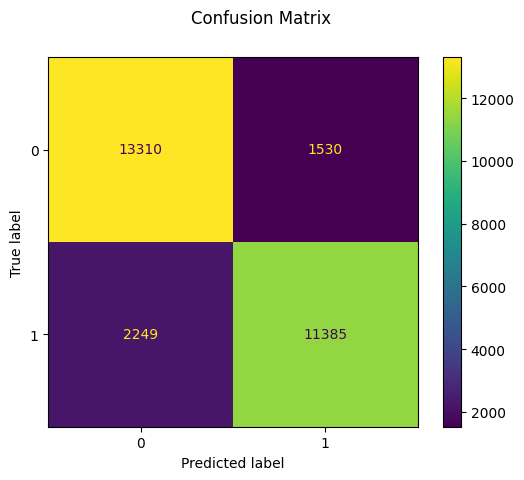

Classification report for classifier DecisionTreeClassifier(class_weight={0: 2.0, 1: 1.0},
                       min_impurity_decrease=0.0001, min_samples_split=20,
                       random_state=0):
              precision    recall  f1-score   support

           0       0.86      0.90      0.88     14840
           1       0.88      0.84      0.86     13634

    accuracy                           0.87     28474
   macro avg       0.87      0.87      0.87     28474
weighted avg       0.87      0.87      0.87     28474




In [ ]:
# latest, building and landuse

X = nominal_data[nominal_features]
# X = nominal_data[foo]
y = nominal_data["is_living"]
weights = {0:2.0, 1:1.0}

# Split data into 80% train and 20% test subsets
X_train, X_test, y_train, y_test = train_test_split(\
    X, y, test_size=0.2, shuffle=True)
dt_split = DecisionTreeClassifier(class_weight=weights,min_samples_split=20, \
                                random_state=0,min_impurity_decrease = 0.0001)

#dt_split = DecisionTreeClassifier(min_samples_split=20, random_state=0,min_impurity_decrease = 0.0001)

# Learn on the train subset
dt_split.fit(X_train, y_train)

# Predict the target on the test subset
predicted = dt_split.predict(X_test)

# 1 = RES; 0 = NON_RES

disp = metrics.ConfusionMatrixDisplay.from_predictions(y_test, predicted)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt_split}:\n"
    f"{metrics.classification_report(y_test, predicted)}\n"
)

In [10]:
feature_importance = pd.DataFrame({
    'feature': nominal_features,
    'importance': dt_split.feature_importances_
})
# Sort by importance
feature_importance = feature_importance.sort_values('importance', ascending=False)
print(feature_importance)

                feature  importance
68  residential_landuse    0.365196
30           apartments    0.145838
0        buffer_cat1_30    0.106273
10       buffer_cat4_60    0.089714
20                 area    0.073598
..                  ...         ...
38              garages    0.000000
37               garage    0.000000
31               church    0.000000
14                brand    0.000000
34         construction    0.000000

[69 rows x 2 columns]


In [21]:
feature_importance

,feature,importance
68,residential_landuse,0.367530
30,apartments,0.145151
0,buffer_cat1_30,0.100714
10,buffer_cat4_60,0.087613
20,area,0.075243
...,...,...
43,industrial,0.000000
45,misc_buildings,0.000000
46,office,0.000000
47,parking,0.000000


In [174]:
toshkent = pd.read_pickle('/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/Datasets/Toshkent/input_data_Яшнабадский_район.pickle')

In [175]:
value_tags = ['building','landuse']
nominal_data_toshkent = toshkent.copy()

nominal_data_toshkent = nominal_transform(nominal_data_toshkent, value_tags)
nominal_features_toshkent = list(nominal_data_toshkent.columns[2:])
nominal_features_toshkent

['buffer_cat1_60',
 'buffer_cat1_90',
 'buffer_cat2_30',
 'buffer_cat2_60',
 'buffer_cat2_90',
 'buffer_cat3_30',
 'buffer_cat3_60',
 'buffer_cat3_90',
 'buffer_cat4_30',
 'buffer_cat4_60',
 'buffer_cat4_90',
 'shop',
 'website',
 'brand',
 'amenity',
 'building:levels',
 'name',
 'addr:street',
 'source',
 'area',
 'parking_cat1',
 'parking_cat2',
 'parking_cat3',
 'parking_cat4',
 'parking_cat5',
 'parking_cat6',
 'parking_cat7',
 'parking_cat8',
 'parking_cat9',
 'apartments',
 'church',
 'civic',
 'commercial',
 'construction',
 'detached',
 'dormitory',
 'garage',
 'garages',
 'greenhouse',
 'hospital',
 'hotel',
 'house',
 'industrial',
 'kindergarten',
 'misc_buildings',
 'office',
 'public',
 'residential',
 'retail',
 'roof',
 'school',
 'semidetached_house',
 'service',
 'shed',
 'terrace',
 'warehouse',
 'yes',
 'cemetery_landuse',
 'construction_landuse',
 'farmyard_landuse',
 'forest_landuse',
 'misc_landuse',
 'no_landuse',
 'non_res_landuse',
 'residential_landuse']

In [40]:
feature_importance

,feature,importance
68,residential_landuse,0.365196
30,apartments,0.145838
0,buffer_cat1_30,0.106273
10,buffer_cat4_60,0.089714
20,area,0.073598
...,...,...
38,garages,0.000000
37,garage,0.000000
31,church,0.000000
14,brand,0.000000


In [18]:
foo = feature_importance.sort_values('importance').tail(33)['feature'].to_list()

In [176]:
list(set(foo) - set(nominal_features_toshkent))

['buffer_cat1_30']

In [177]:
nominal_data_toshkent[list(set(foo) - set(nominal_features_toshkent))] = 0

In [178]:
X_toshkent = nominal_data_toshkent[foo]
# y_tara = nominal_data_toshkent["is_living"]

In [179]:
predicted = dt_split.predict(X_toshkent)

In [180]:
output_data = nominal_data_toshkent.copy()
output_data.drop(columns=['buffer_cat2_30', 'buffer_cat2_60','buffer_cat2_90'], inplace=True)
# output_data.insert(1,'official',y)
output_data.insert(2,'predicted',predicted)
output_filtered = output_data.copy()
#output_filtered = output_filtered[output_filtered['official'] != output_filtered['predicted']]
# output_filtered['official'] = \
#     output_filtered['official'].apply(lambda x: 'RES' if x == 1 else 'NON_RES')
# output_filtered['predicted'] = \
#     output_filtered['predicted'].apply(lambda x: 'RES' if x == 1 else 'NON_RES')

In [186]:
output_data['predicted'].value_counts()

predicted
1    11395
0     7494
Name: count, dtype: int64

In [182]:
output_data.explore('predicted')

In [183]:
output_data.columns

Index(['geometry', 'buffer_cat1_30', 'predicted', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90',
       'buffer_cat4_30', 'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website',
       'brand', 'amenity', 'building:levels', 'name', 'addr:street', 'source',
       'area', 'parking_cat1', 'parking_cat2', 'parking_cat3', 'parking_cat4',
       'parking_cat5', 'parking_cat6', 'parking_cat7', 'parking_cat8',
       'parking_cat9', 'apartments', 'church', 'civic', 'commercial',
       'construction', 'detached', 'dormitory', 'garage', 'garages',
       'greenhouse', 'hospital', 'hotel', 'house', 'industrial',
       'kindergarten', 'misc_buildings', 'office', 'public', 'residential',
       'retail', 'roof', 'school', 'semidetached_house', 'service', 'shed',
       'terrace', 'warehouse', 'yes', 'cemetery_landuse',
       'construction_landuse', 'farmyard_landuse', 'forest_landuse',
       'misc_landuse', 'no_landuse', 'non_res_landuse', 'resi

In [185]:
output_data = output_data[['geometry', 'predicted']]
output_data.to_crs(4326, inplace=True)

In [187]:
output_data.to_file('/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/Datasets/Toshkent/Яшнабадский_район.geojson')

Confusion matrix:
[[2754  299]
 [ 455 1137]]


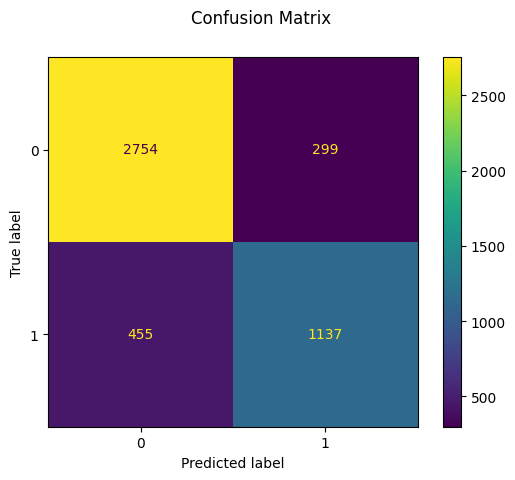

Classification report for classifier DecisionTreeClassifier(class_weight={0: 2.0, 1: 1.0},
                       min_impurity_decrease=0.0001, min_samples_split=20,
                       random_state=0):
              precision    recall  f1-score   support

           0       0.86      0.90      0.88      3053
           1       0.79      0.71      0.75      1592

    accuracy                           0.84      4645
   macro avg       0.82      0.81      0.82      4645
weighted avg       0.84      0.84      0.84      4645




In [105]:
predicted = dt_split.predict(X_tara)

# 1 = RES; 0 = NON_RES

disp = metrics.ConfusionMatrixDisplay.from_predictions(y_tara, predicted)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt_split}:\n"
    f"{metrics.classification_report(y_tara, predicted)}\n"
)

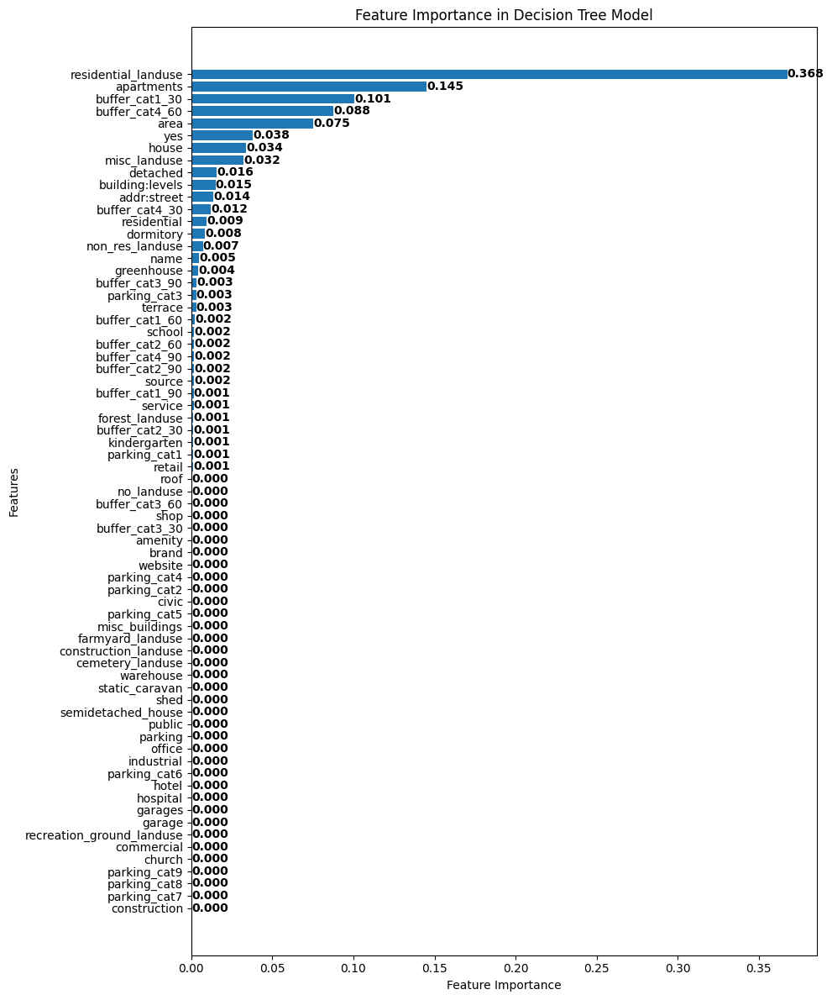

In [17]:
feature_importance = pd.DataFrame({
    'feature': nominal_features,
    'importance': dt_split.feature_importances_
})

# Сортируем по важности
feature_importance = feature_importance.sort_values('importance', ascending=True)

# Создаем визуализацию
plt.figure(figsize=(10, 12))
bars = plt.barh(feature_importance['feature'], feature_importance['importance'])
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance in Decision Tree Model')

# Добавляем значения на конце каждого столбца
for bar in bars:
    width = bar.get_width()
    plt.text(width, 
             bar.get_y() + bar.get_height()/2,
             f'{width:.3f}',
             ha='left',
             va='center',
             fontweight='bold')

plt.tight_layout()
plt.show()

In [39]:
# Visualization using graphviz
dot_data = export_graphviz(dt_split, 
                          feature_names=nominal_features,  
                          class_names=['NON_RES', 'RES'],
                          filled=True, 
                          rounded=True,
                          special_characters=True)
graph = graphviz.Source(dot_data)
graph.render("dt_visualization", view=True)  # Сохранит PDF файл и откроет его

'dt_visualization.pdf'

Confusion matrix:
[[66083  8080]
 [16593 51614]]


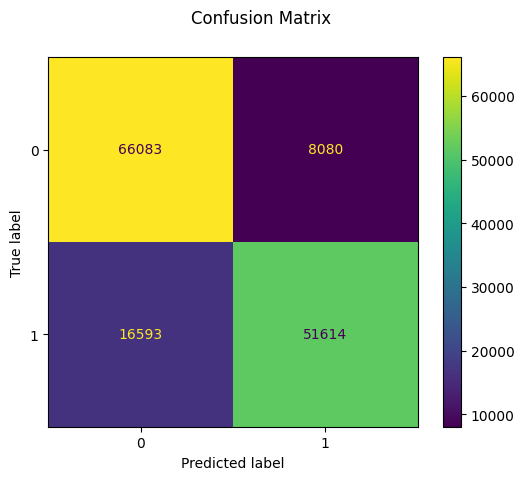

Classification report for classifier DecisionTreeClassifier(class_weight={0: 2.0, 1: 1.0},
                       min_impurity_decrease=0.0001, min_samples_split=20,
                       random_state=0):
              precision    recall  f1-score   support

           0       0.80      0.89      0.84     74163
           1       0.86      0.76      0.81     68207

    accuracy                           0.83    142370
   macro avg       0.83      0.82      0.82    142370
weighted avg       0.83      0.83      0.83    142370




In [62]:
# result for generating output shape file

X = nominal_data[foo]
y = nominal_data["is_living"]

weights = {0:2.0, 1:1.0}
dt = DecisionTreeClassifier(class_weight=weights,min_samples_split=20, random_state=0,min_impurity_decrease = 0.0001)
y_pred = cross_val_predict(dt, X, y, cv=10)
disp = metrics.ConfusionMatrixDisplay.from_predictions(y, y_pred)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt}:\n"
    f"{metrics.classification_report(y, y_pred)}\n"
)